# Molecular orientations and rotations.

This notebook shows how to use [GEMDAT](https://gemdat.readthedocs.org) to compute information related to molecular orientations and rotations.

First, it computes the bonds between central and satellite atoms, following the user's instructions. Then it computes their trajectory in cartesian, spherical and conventional form. If a symmetry group is defined, the statistics can be enhanced by exploiting the symmetry. Now the user can compute and plot the relevant information.

As input you will need:

1. [trajectory](https://gemdat.readthedocs.io/en/latest/api/gemdat_trajectory/#gemdat.trajectory.Trajectory)
2. Orientational indication including:
    - central atom species
    - satellite atom species
    - number of expected neighbors
3. Optionally, a list of transformations that you want to apply to the unit vector trajectory. The user can combine the following operations:
    - `normalize`: the trajectory of unit vectors is scaled to $[0,1]$
    - `transform`: convert the trajectory to conventional coordinate setting or otherwise. The conventional form may be simpler to visualize and compare.
    - `symmetrize`: applies symmetry operations specified via 4.
4. Optionally, the point group, either as:
    - [Hermann–Mauguin notation](https://en.wikipedia.org/wiki/Hermann%E2%80%93Mauguin_notation)
    - Symmetry operations as 3x3 rotation matrices


The resulting orientation information can be visualized on a rectilinear plot, while the user can also access the statistics of the bond length. Finally, it is possible to plot the autocorrelation obtaining information about expected time for rotations. 

## Load the trajectory

We start by loading the trajectory from MD simulations.

In [1]:
from gemdat import Trajectory

# To use your own data:
# trajectory = Trajectory.from_vasprun('path/to/your/vasprun.xml')
from gemdat.utils import VASPCACHE_ORIENTATIONS as VASPCACHE

trajectory = Trajectory.from_cache(VASPCACHE)
trajectory

Full Formula (Li16 S8 O32)
Reduced Formula: Li2SO4
abc   :   9.891300   9.891300   9.891300
angles:  60.000000  60.000000  60.000000
pbc   :       True       True       True
Constant lattice (True)
Sites (56)
Time steps (6666)

## Extract the trajectories of the unit vectors

The entry point to orientation finding is via an [Orientations](https://gemdat.readthedocs.io/en/latest/api/gemdat_orientations/#gemdat.orientations.Orientations) object. It computes the orientations and contains the orientation vectors.

In [2]:
from gemdat import Orientations

oris = Orientations(
    trajectory,
    center_type='S',
    satellite_type='O',
)
oris

Orientations(trajectory=Full Formula (Li16 S8 O32)
Reduced Formula: Li2SO4
abc   :   9.891300   9.891300   9.891300
angles:  60.000000  60.000000  60.000000
pbc   :       True       True       True
Constant lattice (True)
Sites (56)
Time steps (6666), center_type='S', satellite_type='O', vectors=array([[[ 0.47113781,  0.67949494, -1.33022098],
        [-1.58341442,  0.07208362,  0.07481367],
        [ 0.23692508, -1.47092223,  0.07815367],
        ...,
        [ 1.0762701 ,  0.98581556, -0.20011628],
        [-0.57727755, -0.34050784, -1.40376095],
        [-1.11144327,  0.50560628,  0.86053202]],

       [[ 0.5133705 ,  0.65825029, -1.3283309 ],
        [-1.584008  ,  0.05856863,  0.05963306],
        [ 0.26752253, -1.46328622,  0.06763651],
        ...,
        [ 1.04147903,  1.03050253, -0.2146953 ],
        [-0.55834332, -0.30509991, -1.42183269],
        [-1.13202602,  0.51663661,  0.86796779]],

       [[ 0.55669039,  0.63464872, -1.31883796],
        [-1.57243621,  0.04706539,  

You can easily access the unit vectors in direct cartesian coordinates.

In [3]:
vectors = oris.vectors
vectors.shape

(6666, 32, 3)

## transform, normalize, or symmetrize

For example, you can get the normalized conventional coordinates like this by chaining `Orientations.normalize()` and `Orientations.transform()`. The transformation matrix converts from primitive to conventional setting in this case.

In [4]:
import numpy as np

matrix = np.array(
    [
        [1 / 2**0.5, -1 / 6**0.5, 1 / 3**0.5],
        [1 / 2**0.5, 1 / 6**0.5, -1 / 3**0.5],
        [0, 2 / 6**0.5, 1 / 3**0.5],
    ]
)

norm_conv = oris.normalize().transform(matrix)

It is also possible to set different transformation.

In [5]:
eye = np.eye(3)

# and then you can apply them
oris_conv = oris.transform(eye)

It is also possible to use **symmetry** transformations, which are very useful to improve the statistics of the trajectory. To do so, you first have to specify the point group of your molecule or cluster. 

GEMDAT does this via [pymatgen](https://pymatgen.org/pymatgen.symmetry.html#pymatgen.symmetry.analyzer.PointGroupOperations), following the Hemann-Mauguin notation. For example, here we select the Oh point group which is denoted as `m-3m`

In [6]:
oris_sym = oris.symmetrize(sym_group='m-3m')

You can also manually supply the rotation matrices.

In [7]:
sym_ops = np.asarray(
    [
        [[0, 1, 0], [1, 0, 0], [1, 0, 0]],
    ]
)

oris_manual_sym = oris.symmetrize(sym_ops=sym_ops)

It is also possible to convert any trajectory in spherical coordinates

In [8]:
oris_sym.vectors_spherical

array([[[ -27.05856242,  -17.50591411,    1.56626053],
        [-117.05856242,  -17.50591411,    1.56626053],
        [  62.94143758,   17.50591411,    1.56626053],
        ...,
        [ 120.43639939,  -48.07619991,    1.49380695],
        [ 142.25126667,  -19.78358117,    1.49380695],
        [  65.53875343,  -35.17434854,    1.49380695]],

       [[ -26.36057371,  -19.10050609,    1.5688549 ],
        [-116.36057371,  -19.10050609,    1.5688549 ],
        [  63.63942629,   19.10050609,    1.5688549 ],
        ...,
        [ 120.7621889 ,  -48.25794597,    1.51715668],
        [ 142.52123296,  -19.90913747,    1.51715668],
        [  65.46888458,  -34.8969084 ,    1.51715668]],

       [[ -25.69770275,  -20.8247136 ,    1.56589168],
        [-115.69770275,  -20.8247136 ,    1.56589168],
        [  64.30229725,   20.8247136 ,    1.56589168],
        ...,
        [ 120.85978814,  -48.24967883,    1.5369683 ],
        [ 142.54130128,  -19.97187072,    1.5369683 ],
        [  65.40071519

## Plotting

We compute the **rectilinear plot** which is a 2d map of the azimutal and elevation angles.
By *default*, it uses the `transformed_trajectory`, so remember to specify which transformation you want to use.

Here we show the effect of different transformations their ordering.

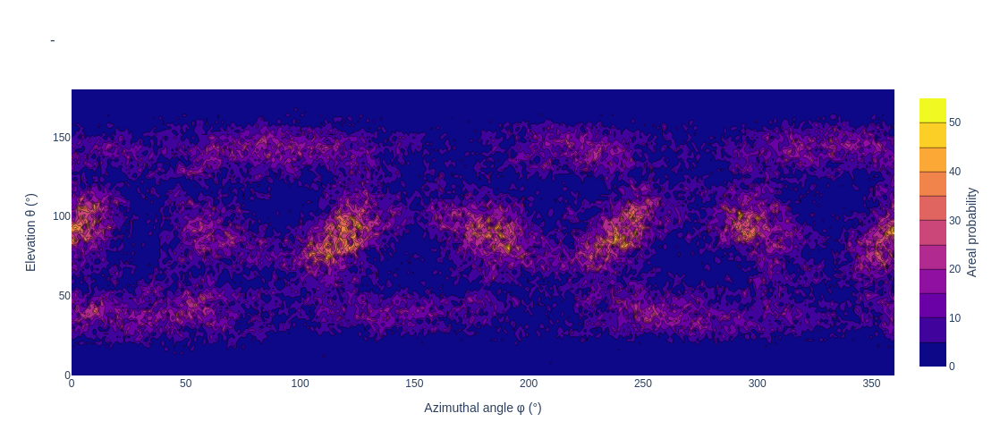

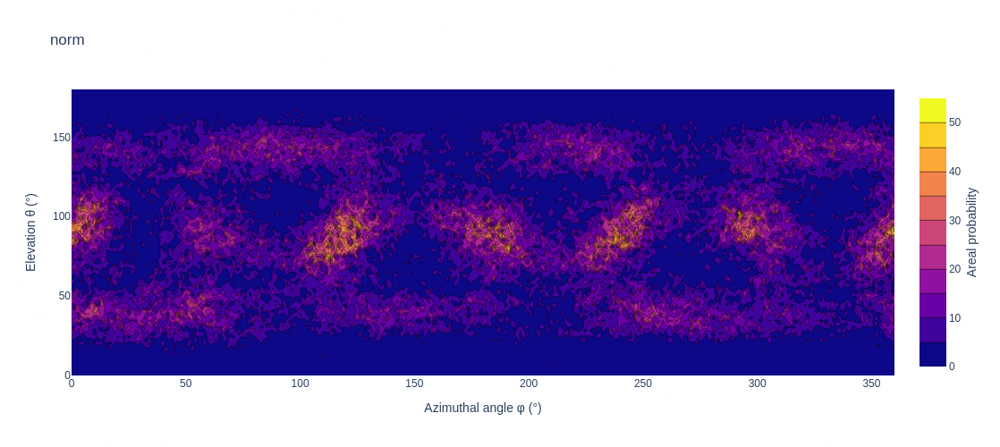

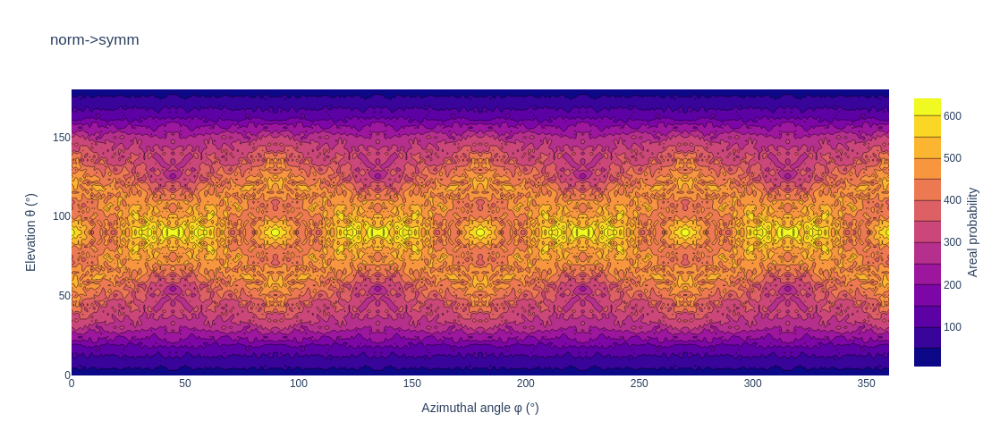

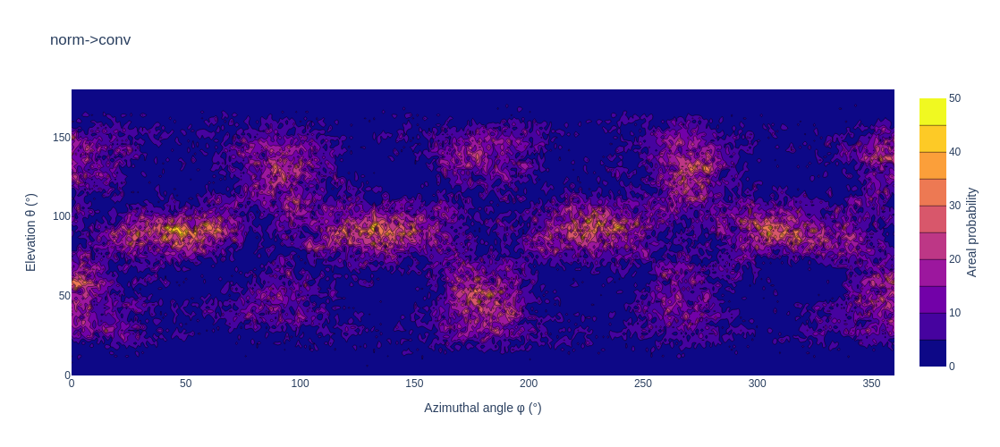

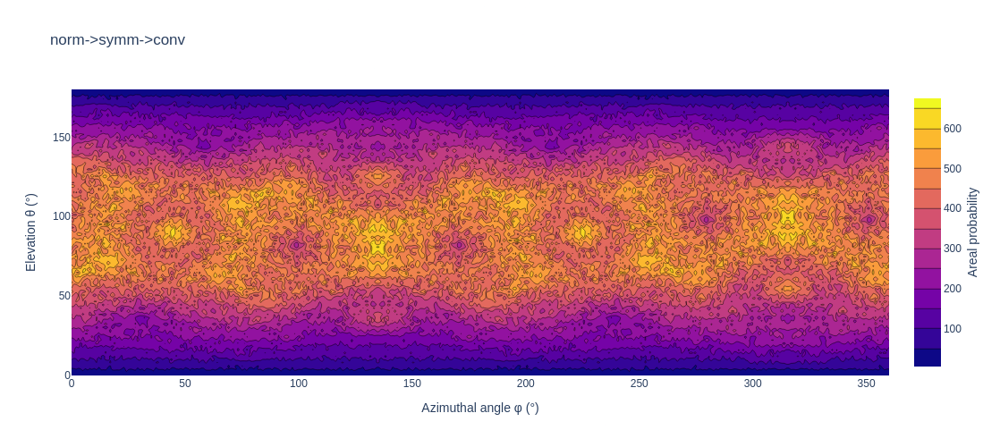

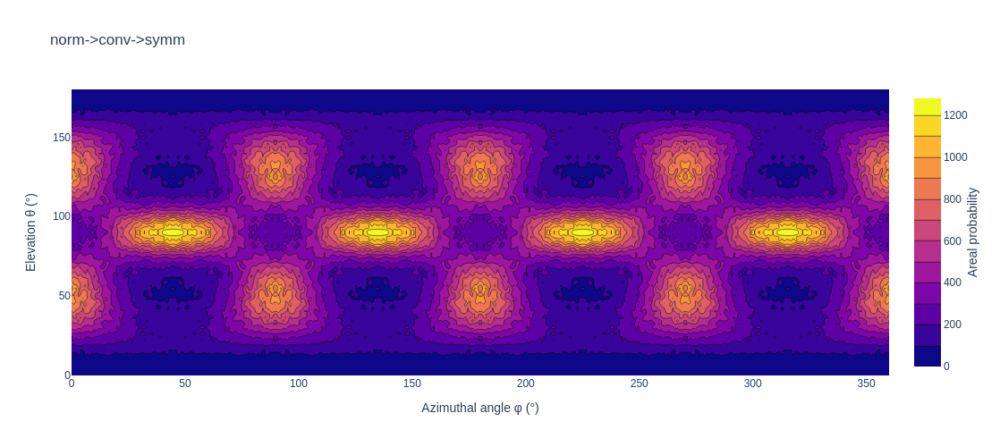

In [9]:
for title, obj in (
    ('-', oris),
    ('norm', oris.normalize()),
    ('norm->symm', oris.normalize().symmetrize(sym_group='m-3m')),
    ('norm->conv', oris.normalize().transform(matrix)),
    ('norm->symm->conv', oris.normalize().symmetrize(sym_group='m-3m').transform(matrix)),
    ('norm->conv->symm', oris.normalize().transform(matrix).symmetrize(sym_group='m-3m')),
):
    fig = obj.plot_rectilinear(normalize_histo=False)
    fig.update_layout(title=title)
    fig.show()

Plot the bond length distribution. A skewed gaussian is automatically fitted to the data in order to provide useful information.

In [10]:
oris.plot_bond_length_distribution(bins=50)

# Autocorrelation

Note that the user can calculate the autocorrelation function like this:

In [11]:
autocorrelation = oris.autocorrelation()

Or, directly plot the autocorrelation of the unit vectors:

In [12]:
oris.plot_autocorrelation()